In [1]:
import os
import sys

In [2]:
# sys.path.append('../input/keras-segmentors/image-segmentation-keras-master')
sys.path.append('../input/kerasdeeplabv3pluslatest/keras-deeplab-v3-plus-master')
#!pip install --upgrade git+https://github.com/divamgupta/image-segmentation-keras

In [3]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import tensorflow as tf
import os
from tqdm import tqdm
from tensorflow.keras.layers import Convolution2D,ZeroPadding2D,Conv2D,MaxPool2D,Dense,BatchNormalization,Dropout,Input,Activation,Flatten,Add,UpSampling2D,MaxPooling2D,Concatenate,AveragePooling2D
from tensorflow.keras import Model
from tensorflow.keras.optimizers import Adam
import tensorflow_addons as tfa
import sys
from multiprocessing.dummy import Pool as ThreadPool
import random
import numpy as np
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.callbacks import ModelCheckpoint
import tensorflow as tf
from tensorflow.keras.models import Model
import tensorflow.keras.backend as K
import os
import time
from skimage.transform import resize
from tensorflow.keras.losses import binary_crossentropy
from model import Deeplabv3
from PIL import Image

## Data Preparation

In [4]:
# Preparing a list of files from training dataset

# Read list of images in a dataframe
filenames_inp=pd.DataFrame({"file_names":os.listdir("../input/massachusetts-roads-dataset/road_segmentation_ideal/training/input")})

# Read list of masks in a dataframe
filenames_output=pd.DataFrame({"file_names":os.listdir("../input/massachusetts-roads-dataset/road_segmentation_ideal/training/output")})

# Since all images do not have masks lets filter out those images
filenames=filenames_inp.loc[filenames_inp.file_names.isin(filenames_output["file_names"]),:]

In [5]:
# Preparing a list of files from test dataset

# Read list of images in a dataframe
val_filenames_inp=pd.DataFrame({"file_names":os.listdir("../input/massachusetts-roads-dataset/road_segmentation_ideal/testing/input")})

# Read list of masks in a dataframe
val_filenames_output=pd.DataFrame({"file_names":os.listdir("../input/massachusetts-roads-dataset/road_segmentation_ideal/testing/output")})

# Since all images do not have masks lets filter out those images
val_filenames=val_filenames_inp.loc[val_filenames_inp.file_names.isin(val_filenames_output["file_names"]),:]

In [6]:
BATCH_SIZE=13
NUM_PARALLEL_CALLS_DS=os.cpu_count()

In [7]:
from tensorflow.keras import backend as K
# Creating the dataset

def get_image_data(image_name):
    img = tf.io.read_file('../input/massachusetts-roads-dataset/road_segmentation_ideal/training/input/' + image_name)
    msk = tf.io.read_file('../input/massachusetts-roads-dataset/road_segmentation_ideal/training/output/' + image_name)
    img=tf.image.decode_png(img)
    msk=tf.image.decode_png(msk)
    return tf.cast(img,tf.float32)/255.,tf.cast(msk,tf.float32)/255.,image_name

def get_image_data_val(image_name):
    img = tf.io.read_file('../input/massachusetts-roads-dataset/road_segmentation_ideal/testing/input/' + image_name)
    msk = tf.io.read_file('../input/massachusetts-roads-dataset/road_segmentation_ideal/testing/output/' + image_name)
    img=tf.image.decode_png(img)
    msk=tf.image.decode_png(msk)
    return tf.cast(img,tf.float32)/255.,tf.cast(msk,tf.float32)/255.,image_name

def get_datasets():
    with tf.device('/cpu:0'):
        train_data=tf.data.Dataset.from_tensor_slices(filenames['file_names']).shuffle(buffer_size=len(filenames)).map(get_image_data,num_parallel_calls=NUM_PARALLEL_CALLS_DS).batch(BATCH_SIZE,drop_remainder=False)
        validation_data=tf.data.Dataset.from_tensor_slices(val_filenames['file_names']).map(get_image_data_val,num_parallel_calls=NUM_PARALLEL_CALLS_DS).batch(BATCH_SIZE,drop_remainder=False)
    return train_data,validation_data

## Load the Model and Define the Metrics

In [8]:
def iou_fun(y_true, y_pred):
    """
        This function calculates intersection over union
    """
    num = K.sum(K.abs(y_true * tf.math.round(y_pred)))
    den = K.sum(K.abs(tf.cast((y_true + tf.math.round(y_pred))!=0,tf.float32)))    
    return num/den


# Load model Deeplabv3
model_final=Deeplabv3(input_shape=(512, 512, 3), classes=1,activation='sigmoid',backbone='xception')

# Load weight of the trained model
model_final.load_weights('../input/roaddetectiondeeplabv3-lr-512/model/model10.hdf5') 

166100992/166096424 [==============================] - 3s 0us/step


In [9]:
!mkdir test_predictions

In [10]:
metric_lst=[]

for cutoff in tqdm([.1,.2,.3,.4,.5,.6,.7]):
    iou_lst=[]
    precision_lst=[]
    recall_lst=[]
    accuracy_lst=[]
    _,validation_data=get_datasets()

    for data in validation_data:        
        patches=tf.image.extract_patches(data[0],
                                             sizes=[1, 512, 512, 1],
                                             strides=[1, 512, 512, 1],
                                             rates=[1, 1, 1, 1],
                                             padding='SAME')

        patches=tf.reshape(patches,(data[0].shape[0]*9,512,512,3))
        predictions=model_final.predict(patches)


        for i in range(data[0].shape[0]):
            prediction_res=np.zeros((512*3,512*3,1))       


            prediction_res[512*0:512*1,512*0:512*1,:]=predictions[0+(i*9),:,:,:]        
            prediction_res[512*0:512*1,512*1:512*2,:]=predictions[1+(i*9),:,:,:]
            prediction_res[512*0:512*1,512*2:512*3,:]=predictions[2+(i*9),:,:,:]


            prediction_res[512*1:512*2,512*0:512*1,:]=predictions[3+(i*9),:,:,:]
            prediction_res[512*1:512*2,512*1:512*2,:]=predictions[4+(i*9),:,:,:]
            prediction_res[512*1:512*2,512*2:512*3,:]=predictions[5+(i*9),:,:,:]


            prediction_res[512*2:512*3,512*0:512*1,:]=predictions[6+(i*9),:,:,:]
            prediction_res[512*2:512*3,512*1:512*2,:]=predictions[7+(i*9),:,:,:]
            prediction_res[512*2:512*3,512*2:512*3,:]=predictions[8+(i*9),:,:,:]




            result=tf.cast(prediction_res[18:-18,18:-18,:]>cutoff,tf.float32)               
            result=result.numpy()



            m = tf.keras.metrics.Precision()
            m.update_state(data[1][i,:,:,:],result)
            precision_lst.append(m.result().numpy())

            m = tf.keras.metrics.Recall()
            m.update_state(data[1][i,:,:,:],result)
            recall_lst.append(m.result().numpy())

            m = tf.keras.metrics.Accuracy()
            m.update_state(data[1][i,:,:,:],result)
            accuracy_lst.append(m.result().numpy()) 

            res_iou=iou_fun(data[1][i,:,:,:],result)  
            iou_lst.append(res_iou)            
            plt.show()
    metric_lst.append([np.mean(iou_lst),np.mean(precision_lst),np.mean(recall_lst),np.mean(accuracy_lst)])    
 

metric_df=pd.DataFrame(metric_lst,index=['p1','p2','p3','p4','p5','p6','p7'],columns=['iou','precision','recall','accuracy'])

metric_df

100%|██████████| 7/7 [24:00<00:00, 205.78s/it]


,iou,precision,recall,accuracy
p1,0.531267,0.577087,0.872583,0.947554
p2,0.580988,0.666073,0.820519,0.959502
p3,0.596643,0.721319,0.775136,0.964006
p4,0.596556,0.763958,0.730564,0.966000
p5,0.584912,0.800355,0.683745,0.966575
p6,0.560681,0.833035,0.630520,0.965994
p7,0.520660,0.865307,0.565580,0.964178


<h1>Storing final predictions and Visualize at cutoff=0.4 :- </h1>

(13, 1500, 1500, 3)
[0. 1.]
Till Mean IOU: 0.55663365


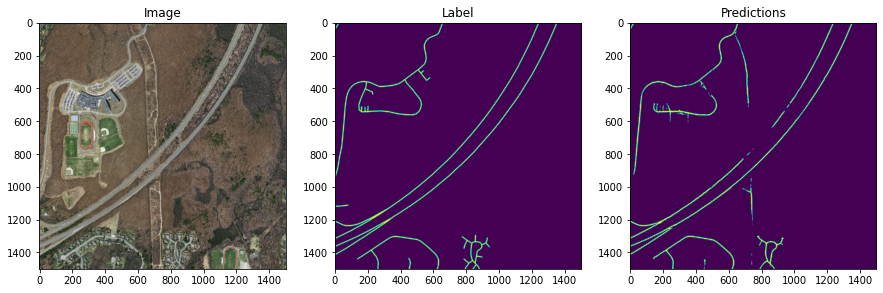

[0. 1.]
Till Mean IOU: 0.5480875


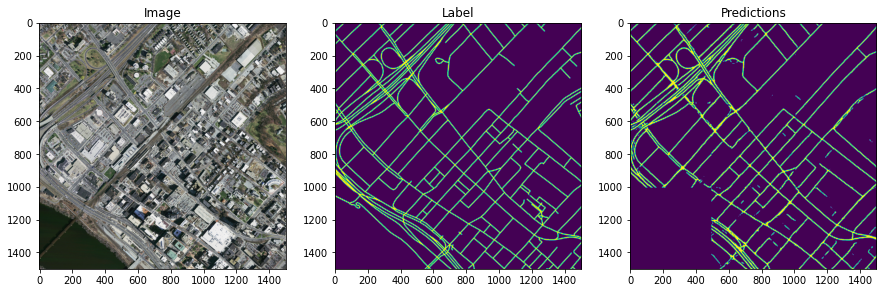

[0. 1.]
Till Mean IOU: 0.5860412


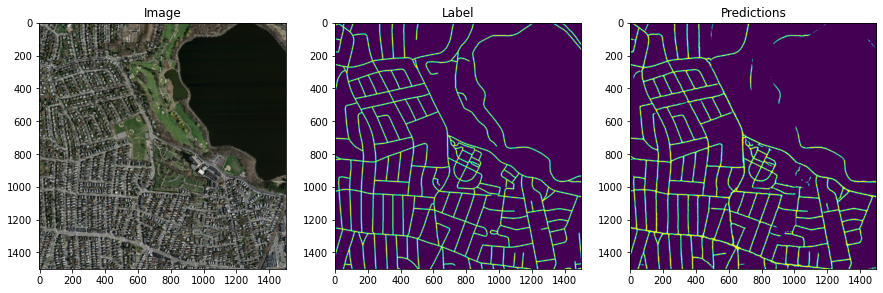

[0. 1.]
Till Mean IOU: 0.60114294


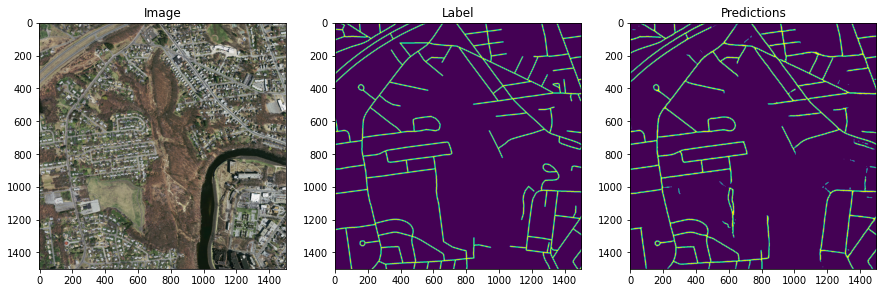

[0. 1.]
Till Mean IOU: 0.59870666


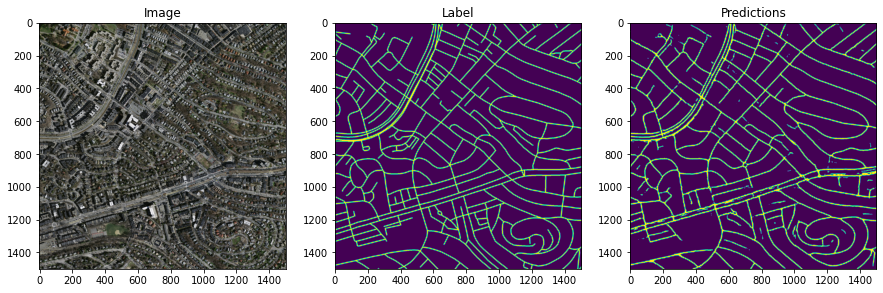

[0. 1.]
Till Mean IOU: 0.5910114


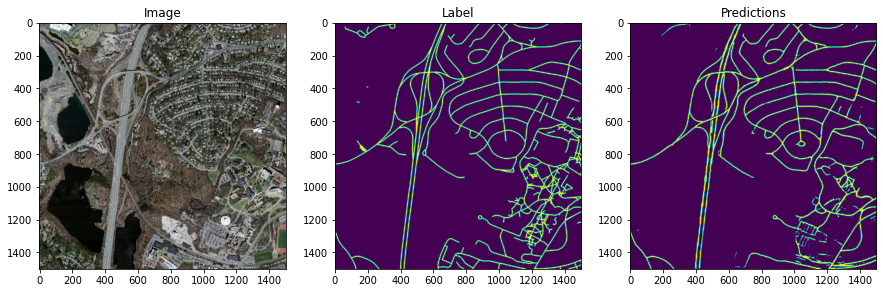

[0. 1.]
Till Mean IOU: 0.599264


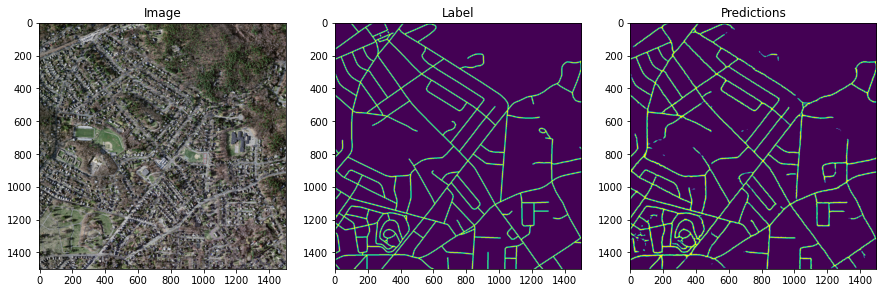

[0. 1.]
Till Mean IOU: 0.6095736


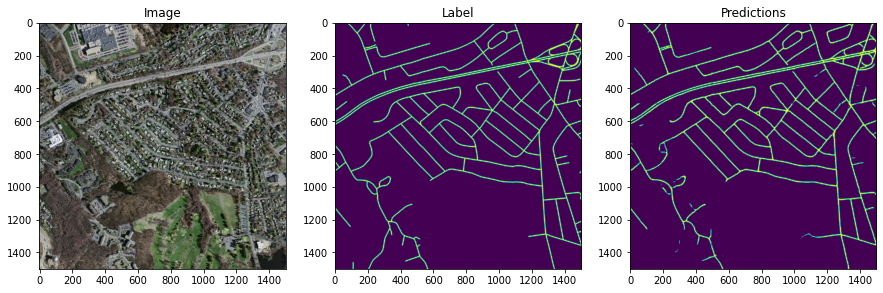

[0. 1.]
Till Mean IOU: 0.5955266


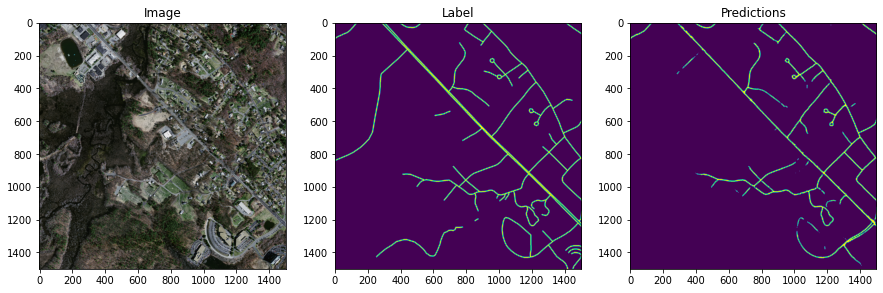

[0. 1.]
Till Mean IOU: 0.5978651


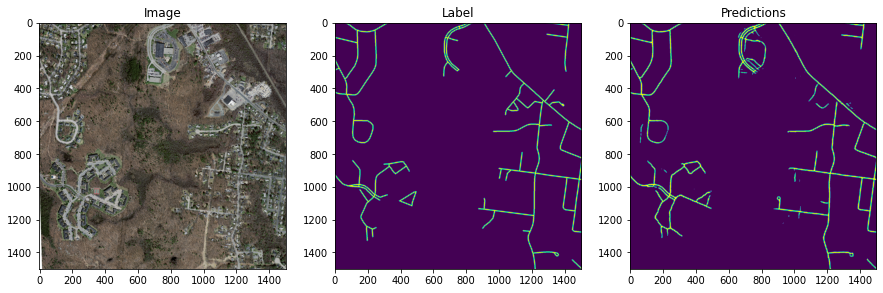

[0. 1.]
Till Mean IOU: 0.5989522


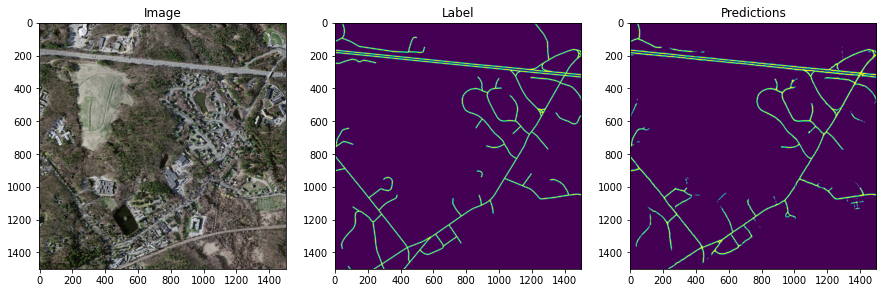

[0. 1.]
Till Mean IOU: 0.58955306


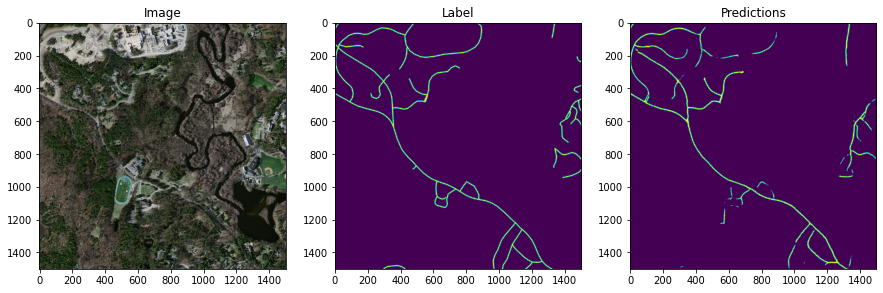

[0. 1.]
Till Mean IOU: 0.5965558


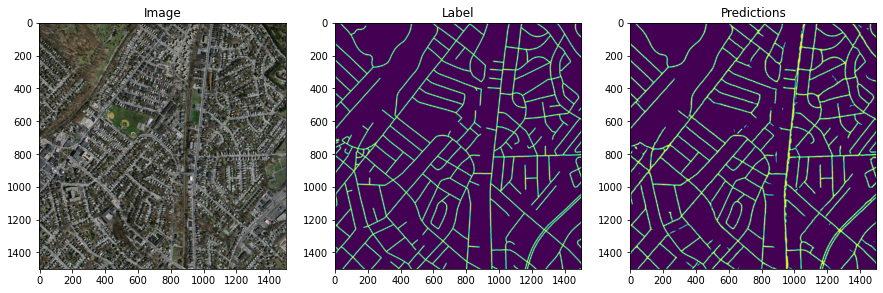

Mean IOU: 0.5965558
std IOU: 0.06585166
z IOU: 9.059086
Mean Precision: 0.76395786
Mean Recall: 0.7305644
Mean Accuracy: 0.9659997


In [11]:
iou_lst=[]
precision_lst=[]
recall_lst=[]
accuracy_lst=[]
_,validation_data=get_datasets()

for data in validation_data:
    print(data[0].shape)
    patches=tf.image.extract_patches(data[0],
                                         sizes=[1, 512, 512, 1],
                                         strides=[1, 512, 512, 1],
                                         rates=[1, 1, 1, 1],
                                         padding='SAME')
    
    patches=tf.reshape(patches,(data[0].shape[0]*9,512,512,3))
    predictions=model_final.predict(patches)
    
    for i in range(data[0].shape[0]):
        prediction_res=np.zeros((512*3,512*3,1))       
        
        
        prediction_res[512*0:512*1,512*0:512*1,:]=predictions[0+(i*9),:,:,:]        
        prediction_res[512*0:512*1,512*1:512*2,:]=predictions[1+(i*9),:,:,:]
        prediction_res[512*0:512*1,512*2:512*3,:]=predictions[2+(i*9),:,:,:]
        
        
        prediction_res[512*1:512*2,512*0:512*1,:]=predictions[3+(i*9),:,:,:]
        prediction_res[512*1:512*2,512*1:512*2,:]=predictions[4+(i*9),:,:,:]
        prediction_res[512*1:512*2,512*2:512*3,:]=predictions[5+(i*9),:,:,:]
        
        
        prediction_res[512*2:512*3,512*0:512*1,:]=predictions[6+(i*9),:,:,:]
        prediction_res[512*2:512*3,512*1:512*2,:]=predictions[7+(i*9),:,:,:]
        prediction_res[512*2:512*3,512*2:512*3,:]=predictions[8+(i*9),:,:,:]
        


        fig,(ax1,ax2,ax3)=plt.subplots(1,3,figsize=(15, 5))
        ax1.imshow(data[0][i,:,:,:])
        ax1.set_title('Image')
        
        ax2.imshow(data[1][i,:,:,:])
        ax2.set_title('Label')
        
        result=tf.cast(prediction_res[18:-18,18:-18,:]>0.4,tf.float32)
        ax3.imshow(result)
        ax3.set_title('Predictions')
        
        result=result.numpy()
        print(np.unique(result))
        im = Image.fromarray(np.squeeze(result*255).astype(np.uint8))
        im.save("./test_predictions/" + data[2][i].numpy().decode('utf8'))
        
        
        m = tf.keras.metrics.Precision()
        m.update_state(data[1][i,:,:,:],result)
        precision_lst.append(m.result().numpy())
        
        m = tf.keras.metrics.Recall()
        m.update_state(data[1][i,:,:,:],result)
        recall_lst.append(m.result().numpy())
        
        m = tf.keras.metrics.Accuracy()
        m.update_state(data[1][i,:,:,:],result)
        accuracy_lst.append(m.result().numpy()) 
        
        res_iou=iou_fun(data[1][i,:,:,:],result)  
        iou_lst.append(res_iou)
        print('Till Mean IOU:',np.mean(iou_lst))
        plt.show()
        
print("Mean IOU:",np.mean(iou_lst))
print("std IOU:",np.std(iou_lst))
print("z IOU:",np.mean(iou_lst)/np.std(iou_lst))
print("Mean Precision:",np.mean(precision_lst))
print("Mean Recall:",np.mean(recall_lst))
print("Mean Accuracy:",np.mean(accuracy_lst))

<h1>Visualization  of some predictions:-</h1>

<h2>Visualizing and evaluation at cutoff-0.4 with TTA :-</h2>

In [12]:
class FlipLayer(tf.keras.layers.Layer):
    def __init__(self, flip_type, **kwargs):
        super(FlipLayer, self).__init__(**kwargs)
        self.flip_type = flip_type
    
    def call(self, images, training=None):
        if self.flip_type=="horizontal":
            return tf.map_fn(tf.image.flip_left_right,images)
        if self.flip_type=="vertical":
            return tf.map_fn(tf.image.flip_up_down,images)
        
flip_horizontal=FlipLayer(flip_type="horizontal")
flip_vertical=FlipLayer(flip_type="vertical")



def predict_tta(patches):
    predictions=model_final.predict(patches)
    predictions_h=flip_horizontal(model_final.predict(flip_horizontal(patches)))
    predictions_v=flip_vertical(model_final.predict(flip_vertical(patches)))
    return (predictions+predictions_h+predictions_v)/3



(13, 1500, 1500, 3)
[0. 1.]
Till Mean IOU: 0.6027048


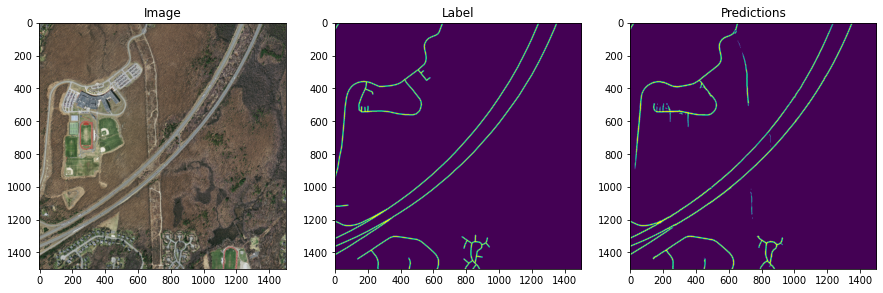

[0. 1.]
Till Mean IOU: 0.5724853


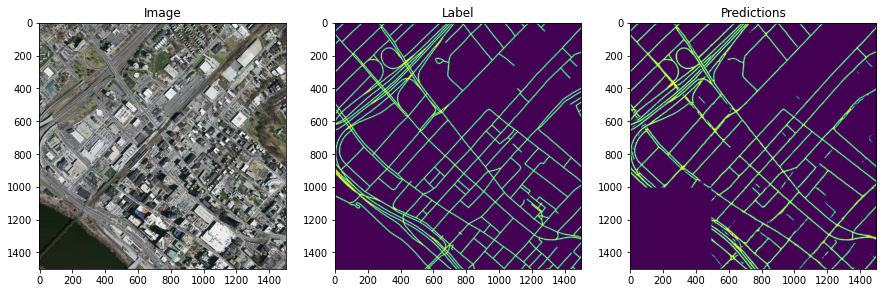

[0. 1.]
Till Mean IOU: 0.60580665


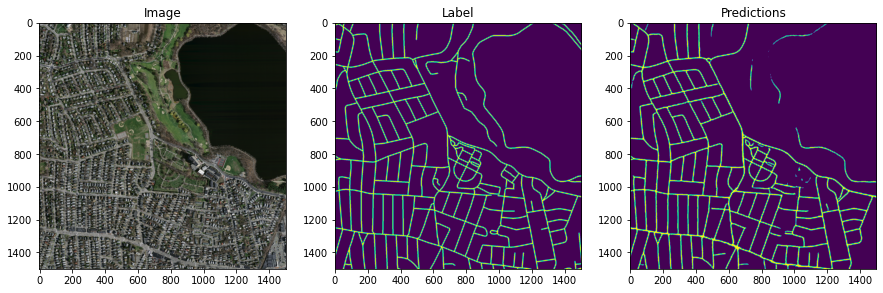

[0. 1.]
Till Mean IOU: 0.61820656


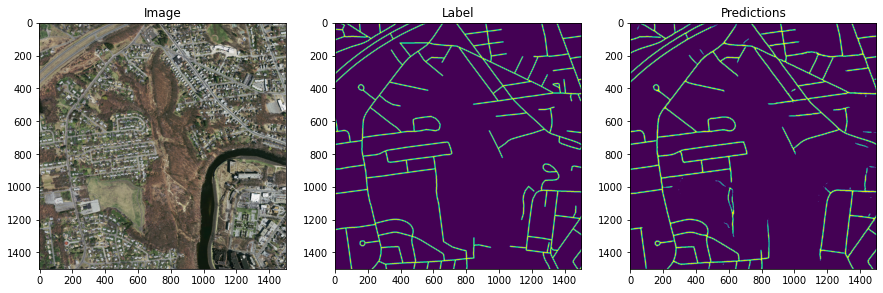

[0. 1.]
Till Mean IOU: 0.6152504


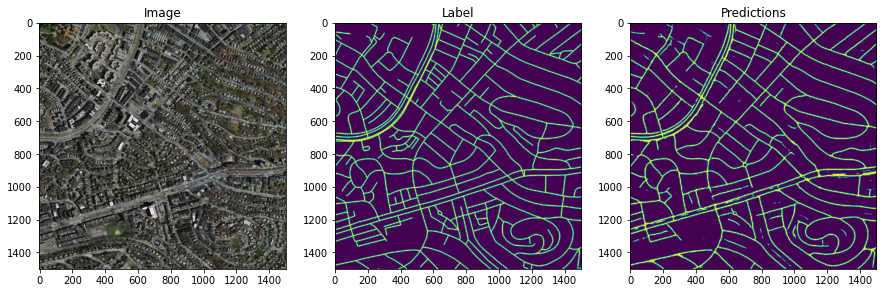

[0. 1.]
Till Mean IOU: 0.6068339


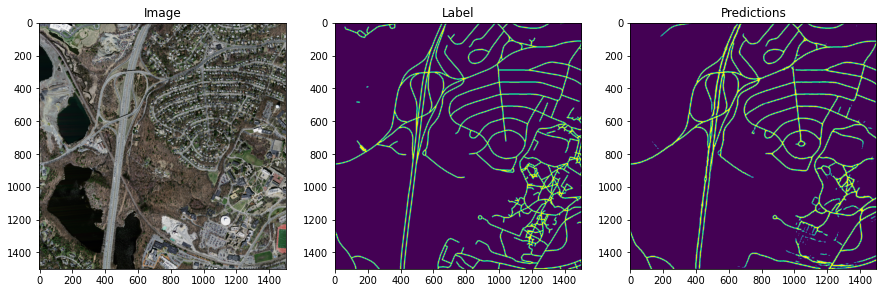

[0. 1.]
Till Mean IOU: 0.6151928


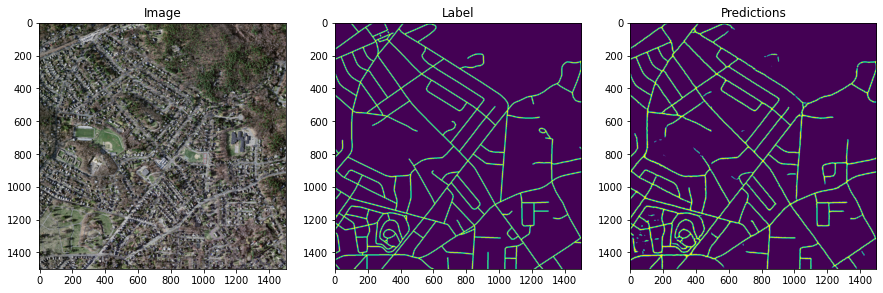

[0. 1.]
Till Mean IOU: 0.62505275


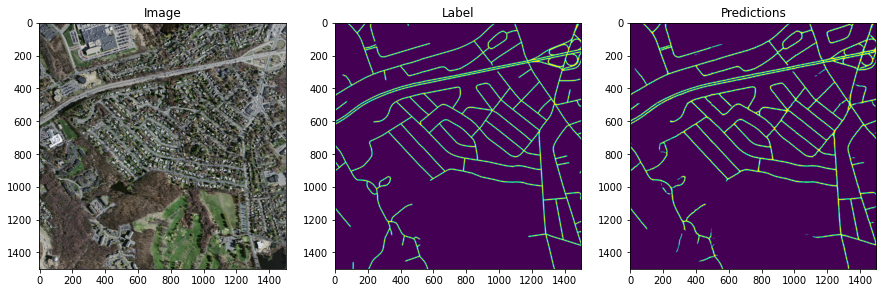

[0. 1.]
Till Mean IOU: 0.61047375


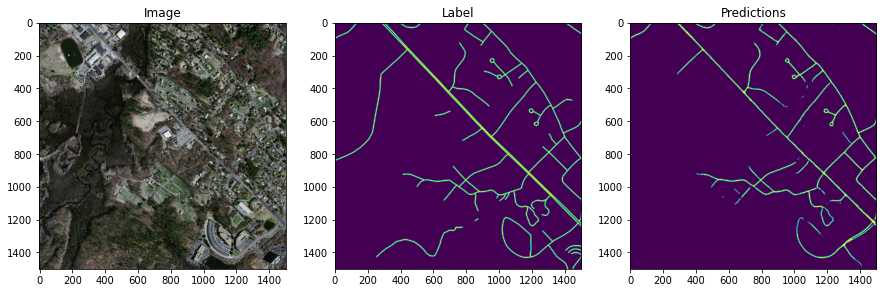

[0. 1.]
Till Mean IOU: 0.6137913


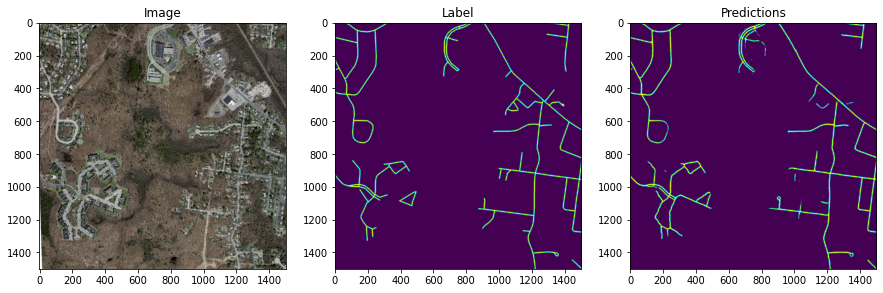

[0. 1.]
Till Mean IOU: 0.6152956


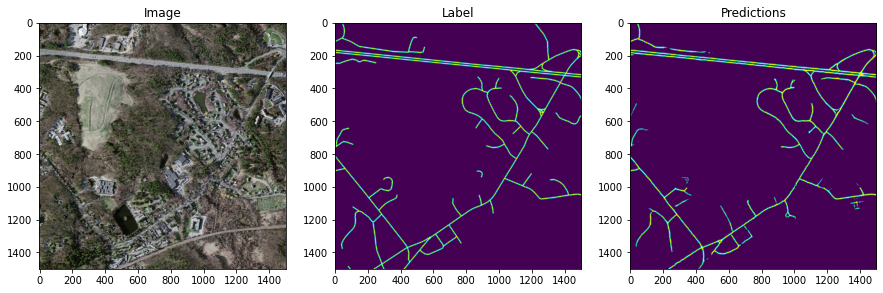

[0. 1.]
Till Mean IOU: 0.6054824


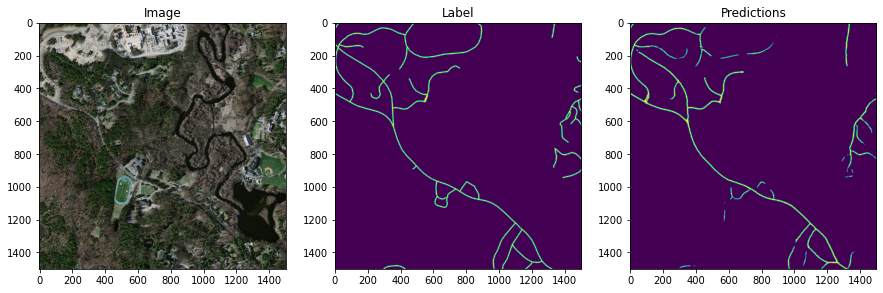

[0. 1.]
Till Mean IOU: 0.61194354


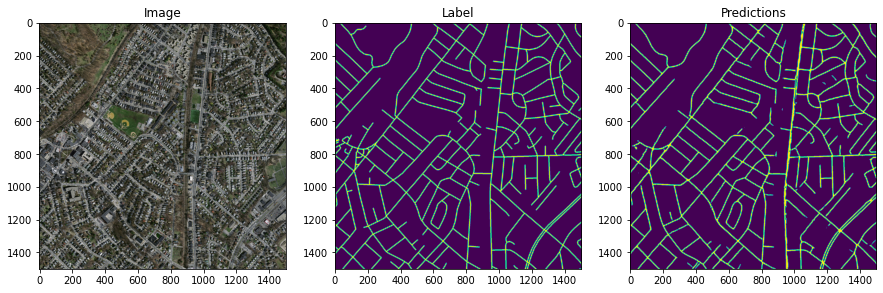

Mean IOU: 0.61194354
std IOU: 0.06608784
z IOU: 9.259548
Mean Precision: 0.77796924
Mean Recall: 0.74043834
Mean Accuracy: 0.9674428


In [13]:
iou_lst=[]
precision_lst=[]
recall_lst=[]
accuracy_lst=[]
_,validation_data=get_datasets()

for data in validation_data:
    print(data[0].shape)
    patches=tf.image.extract_patches(data[0],
                                         sizes=[1, 512, 512, 1],
                                         strides=[1, 512, 512, 1],
                                         rates=[1, 1, 1, 1],
                                         padding='SAME')
    
    patches=tf.reshape(patches,(data[0].shape[0]*9,512,512,3))
    predictions=predict_tta(patches)
    
    for i in range(data[0].shape[0]):
        prediction_res=np.zeros((512*3,512*3,1))       
        
        
        prediction_res[512*0:512*1,512*0:512*1,:]=predictions[0+(i*9),:,:,:]        
        prediction_res[512*0:512*1,512*1:512*2,:]=predictions[1+(i*9),:,:,:]
        prediction_res[512*0:512*1,512*2:512*3,:]=predictions[2+(i*9),:,:,:]
        
        
        prediction_res[512*1:512*2,512*0:512*1,:]=predictions[3+(i*9),:,:,:]
        prediction_res[512*1:512*2,512*1:512*2,:]=predictions[4+(i*9),:,:,:]
        prediction_res[512*1:512*2,512*2:512*3,:]=predictions[5+(i*9),:,:,:]
        
        
        prediction_res[512*2:512*3,512*0:512*1,:]=predictions[6+(i*9),:,:,:]
        prediction_res[512*2:512*3,512*1:512*2,:]=predictions[7+(i*9),:,:,:]
        prediction_res[512*2:512*3,512*2:512*3,:]=predictions[8+(i*9),:,:,:]
        


        fig,(ax1,ax2,ax3)=plt.subplots(1,3,figsize=(15, 5))
        ax1.imshow(data[0][i,:,:,:])
        ax1.set_title('Image')
        
        ax2.imshow(data[1][i,:,:,:])
        ax2.set_title('Label')
        
        result=tf.cast(prediction_res[18:-18,18:-18,:]>0.4,tf.float32)
        ax3.imshow(result)
        ax3.set_title('Predictions')
        
        result=result.numpy()
        print(np.unique(result))
        im = Image.fromarray(np.squeeze(result*255).astype(np.uint8))
        im.save("./test_predictions/" + data[2][i].numpy().decode('utf8'))
        
        
        m = tf.keras.metrics.Precision()
        m.update_state(data[1][i,:,:,:],result)
        precision_lst.append(m.result().numpy())
        
        m = tf.keras.metrics.Recall()
        m.update_state(data[1][i,:,:,:],result)
        recall_lst.append(m.result().numpy())
        
        m = tf.keras.metrics.Accuracy()
        m.update_state(data[1][i,:,:,:],result)
        accuracy_lst.append(m.result().numpy()) 
        
        res_iou=iou_fun(data[1][i,:,:,:],result)  
        iou_lst.append(res_iou)
        print('Till Mean IOU:',np.mean(iou_lst))
        plt.show()
        
print("Mean IOU:",np.mean(iou_lst))
print("std IOU:",np.std(iou_lst))
print("z IOU:",np.mean(iou_lst)/np.std(iou_lst))
print("Mean Precision:",np.mean(precision_lst))
print("Mean Recall:",np.mean(recall_lst))
print("Mean Accuracy:",np.mean(accuracy_lst))

<h2> Visualization For Cutoff=0.1</h2>

(13, 1500, 1500, 3)
[0. 1.]
Till Mean IOU: 0.49024934


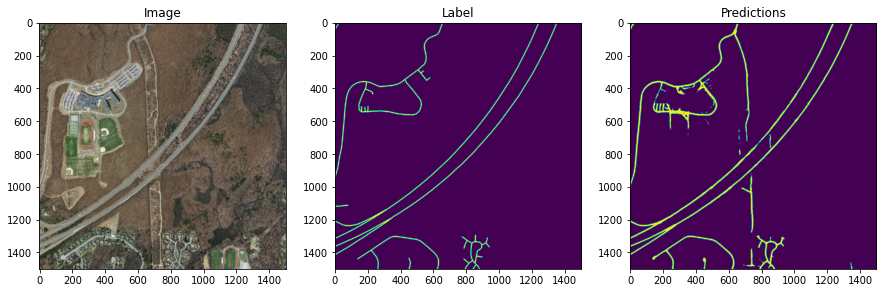

[0. 1.]
Till Mean IOU: 0.49459213


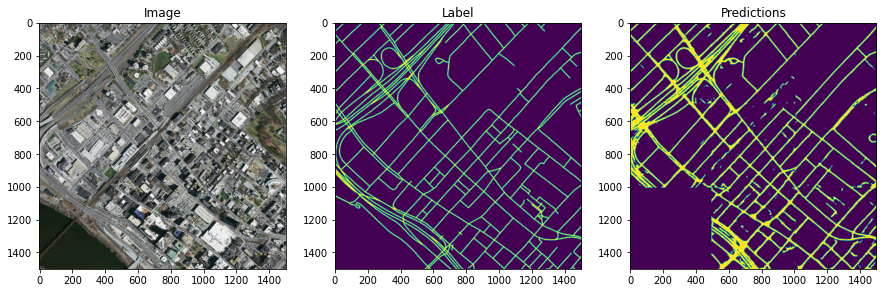

[0. 1.]
Till Mean IOU: 0.53937274


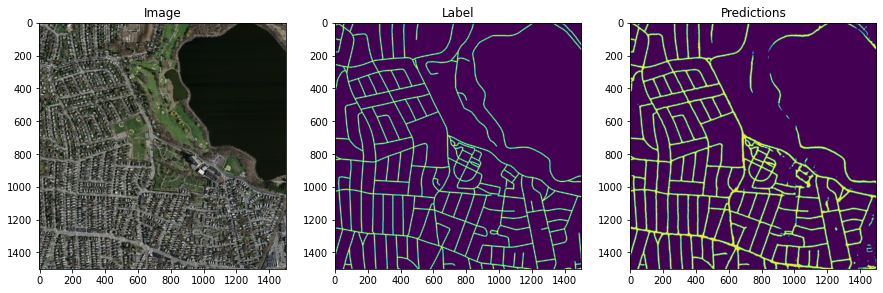

[0. 1.]
Till Mean IOU: 0.5462899


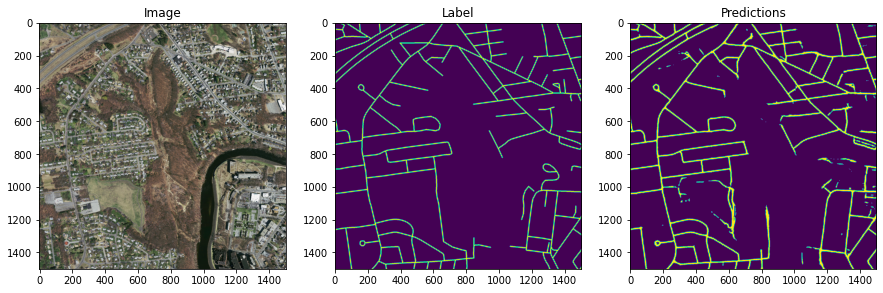

[0. 1.]
Till Mean IOU: 0.5406479


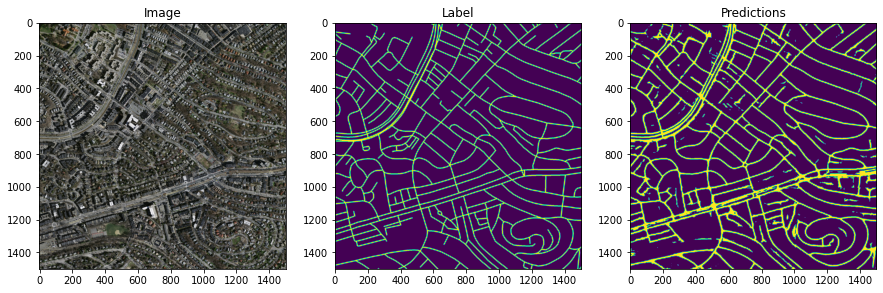

[0. 1.]
Till Mean IOU: 0.5353229


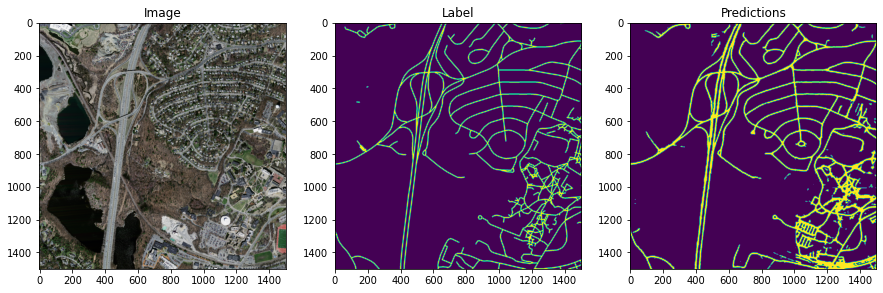

[0. 1.]
Till Mean IOU: 0.5411236


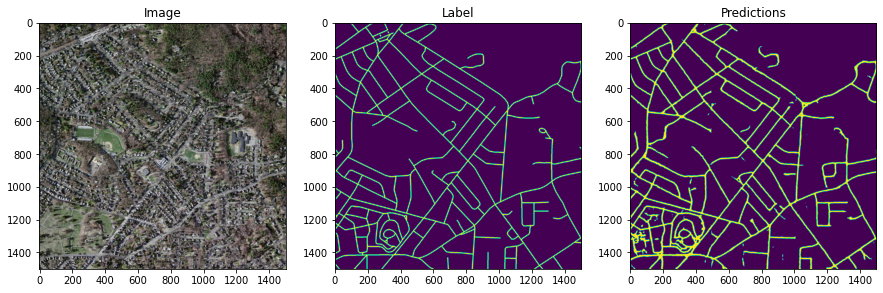

[0. 1.]
Till Mean IOU: 0.5481263


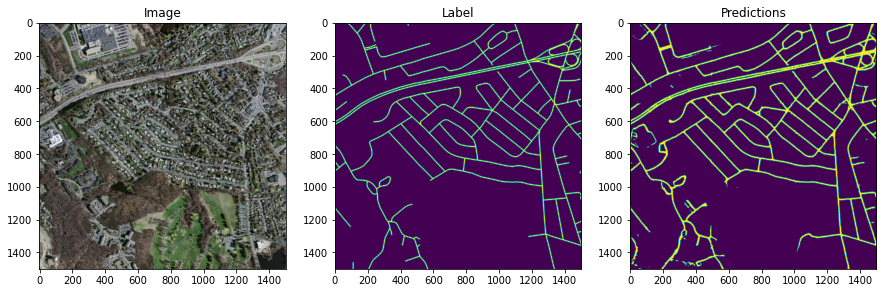

[0. 1.]
Till Mean IOU: 0.5433599


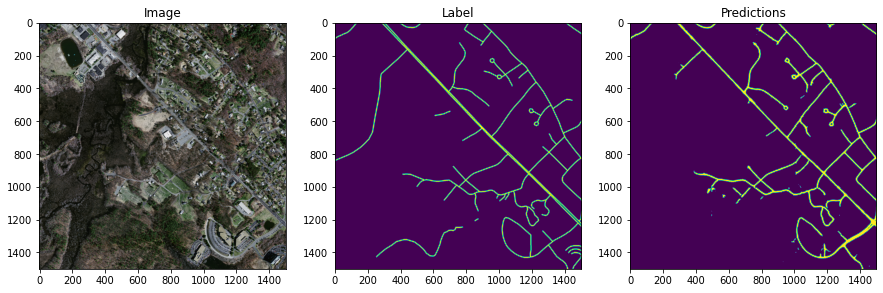

[0. 1.]
Till Mean IOU: 0.53745264


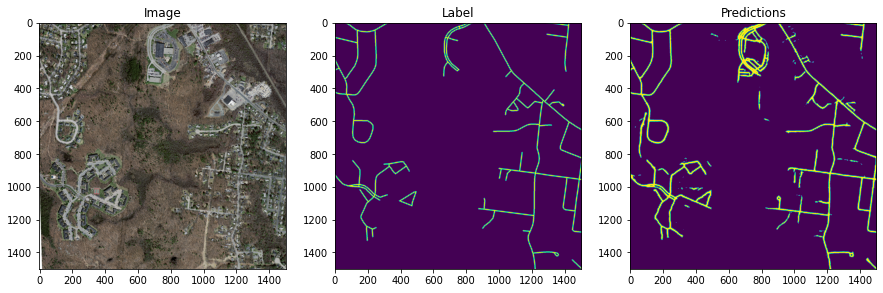

[0. 1.]
Till Mean IOU: 0.5374783


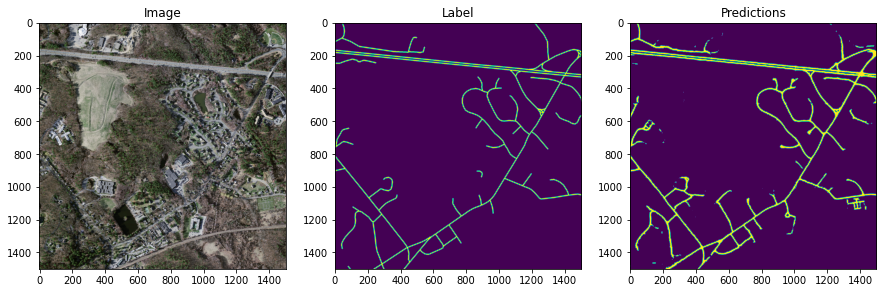

[0. 1.]
Till Mean IOU: 0.52630377


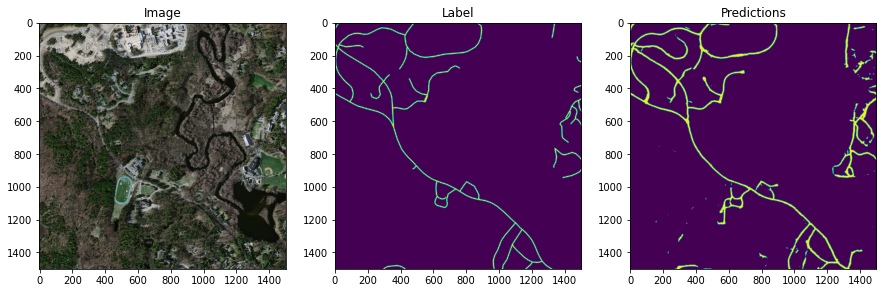

[0. 1.]
Till Mean IOU: 0.5312671


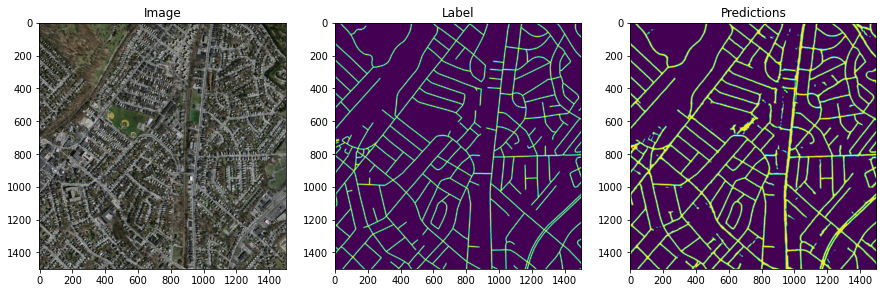

Mean IOU: 0.5312671
std IOU: 0.057774585
z IOU: 9.195516


In [14]:
iou_lst=[]

_,validation_data=get_datasets()
for data in iter(validation_data):
    print(data[0].shape)
    patches=tf.image.extract_patches(data[0],
                                         sizes=[1, 512, 512, 1],
                                         strides=[1, 512, 512, 1],
                                         rates=[1, 1, 1, 1],
                                         padding='SAME')
    
    patches=tf.reshape(patches,(data[0].shape[0]*9,512,512,3))
    predictions=model_final.predict(patches)
    
    for i in range(data[0].shape[0]):
        prediction_res=np.zeros((512*3,512*3,1))       
        
        
        prediction_res[512*0:512*1,512*0:512*1,:]=predictions[0+(i*9),:,:,:]        
        prediction_res[512*0:512*1,512*1:512*2,:]=predictions[1+(i*9),:,:,:]
        prediction_res[512*0:512*1,512*2:512*3,:]=predictions[2+(i*9),:,:,:]
        
        
        prediction_res[512*1:512*2,512*0:512*1,:]=predictions[3+(i*9),:,:,:]
        prediction_res[512*1:512*2,512*1:512*2,:]=predictions[4+(i*9),:,:,:]
        prediction_res[512*1:512*2,512*2:512*3,:]=predictions[5+(i*9),:,:,:]
        
        
        prediction_res[512*2:512*3,512*0:512*1,:]=predictions[6+(i*9),:,:,:]
        prediction_res[512*2:512*3,512*1:512*2,:]=predictions[7+(i*9),:,:,:]
        prediction_res[512*2:512*3,512*2:512*3,:]=predictions[8+(i*9),:,:,:]
        
        
        fig,(ax1,ax2,ax3)=plt.subplots(1,3,figsize=(15, 5))
        ax1.imshow(data[0][i,:,:,:])
        ax1.set_title('Image')
        
        ax2.imshow(data[1][i,:,:,:])
        ax2.set_title('Label')
        
        result=tf.cast(prediction_res[18:-18,18:-18,:]>0.1,tf.float32)
        ax3.imshow(result)
        ax3.set_title('Predictions')                
        
        result=result.numpy()
        print(np.unique(result))
#         im = Image.fromarray(np.squeeze(result*255).astype(np.uint8))
#         im.save("test_predictions/" + data[2][i].numpy().decode('utf8'))
        res_iou=iou_fun(data[1][i,:,:,:],result)        
        iou_lst.append(res_iou)
        print('Till Mean IOU:',np.mean(iou_lst))
        plt.show()
print("Mean IOU:",np.mean(iou_lst))
print("std IOU:",np.std(iou_lst))
print("z IOU:",np.mean(iou_lst)/np.std(iou_lst))

<h2> Visualization For Cutoff=0.2</h2>

(13, 1500, 1500, 3)
[0. 1.]
Till Mean IOU: 0.5358666


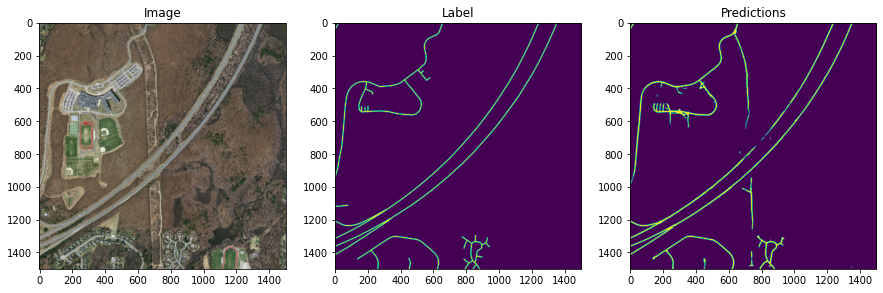

[0. 1.]
Till Mean IOU: 0.5375681


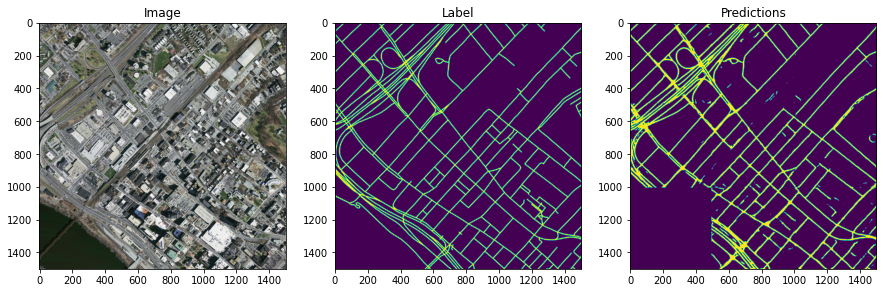

[0. 1.]
Till Mean IOU: 0.5790756


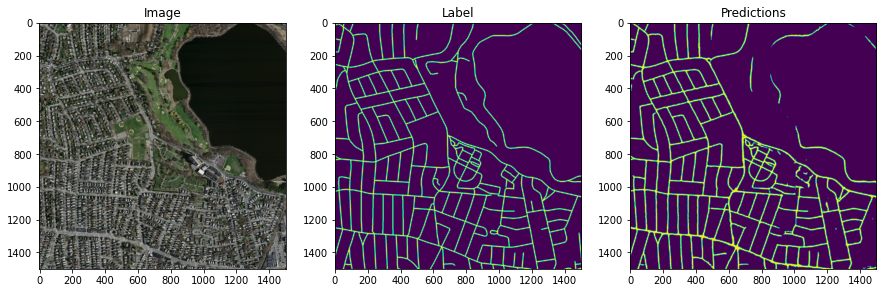

[0. 1.]
Till Mean IOU: 0.5902539


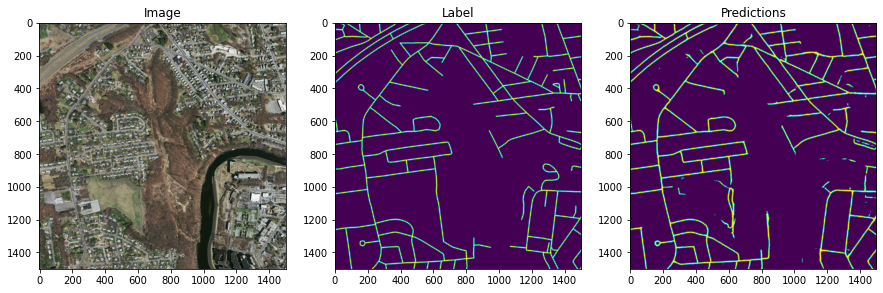

[0. 1.]
Till Mean IOU: 0.58578265


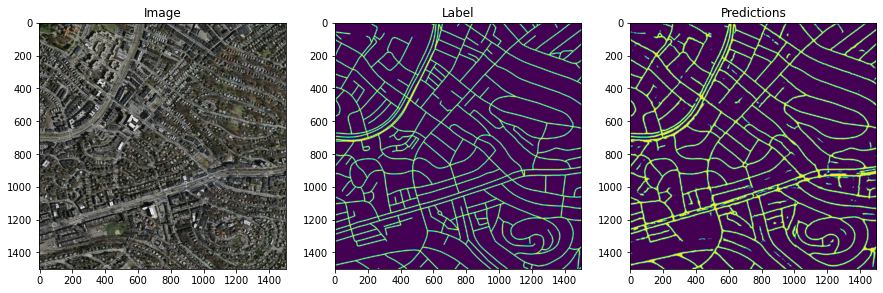

[0. 1.]
Till Mean IOU: 0.57949734


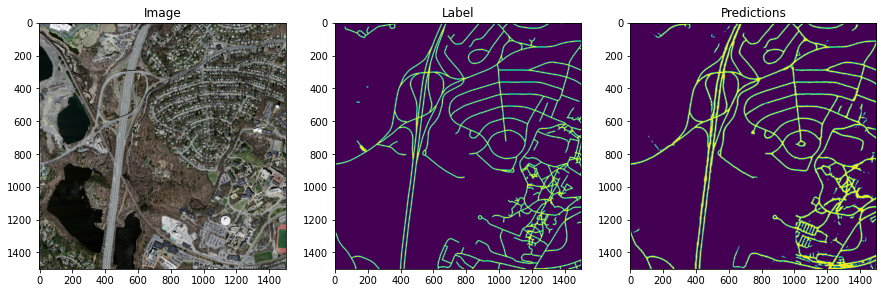

[0. 1.]
Till Mean IOU: 0.5857024


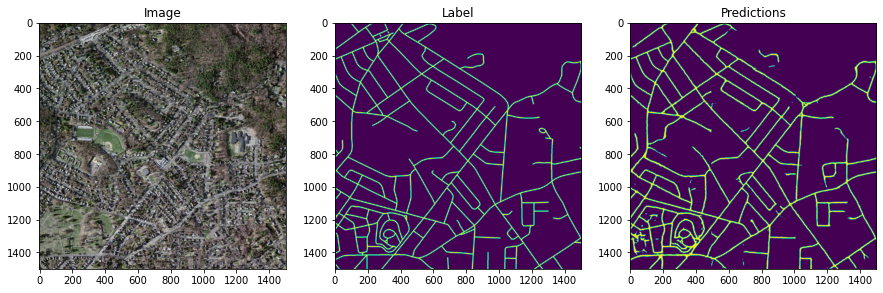

[0. 1.]
Till Mean IOU: 0.5945606


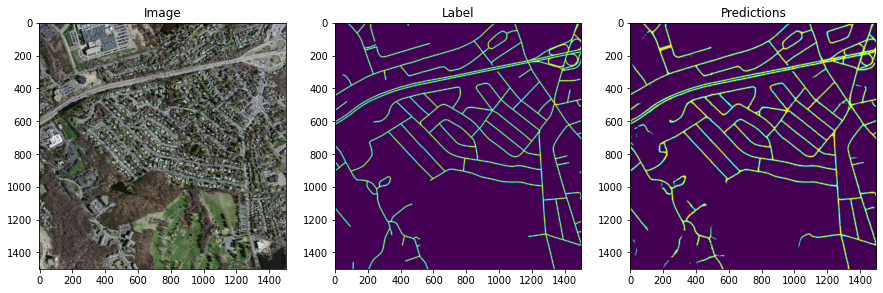

[0. 1.]
Till Mean IOU: 0.5860701


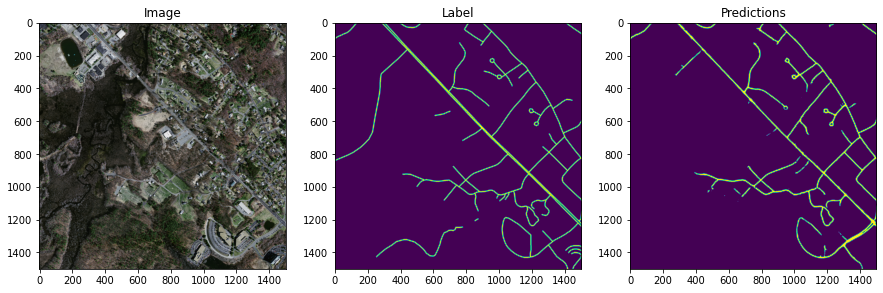

[0. 1.]
Till Mean IOU: 0.5837768


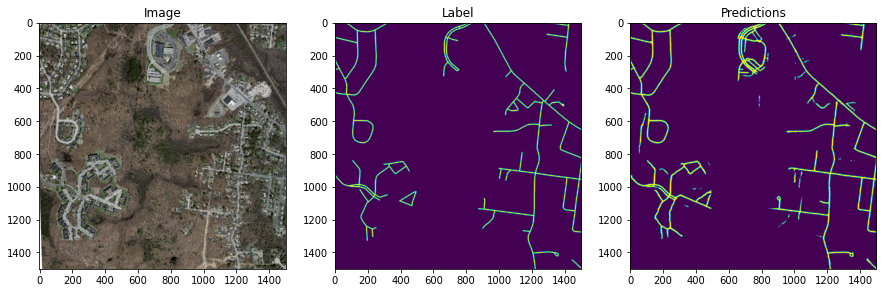

[0. 1.]
Till Mean IOU: 0.584567


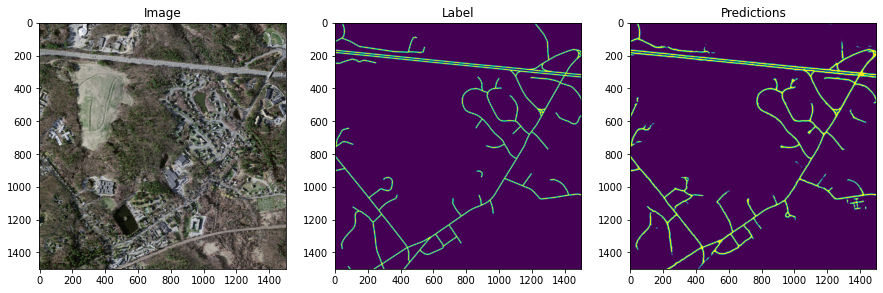

[0. 1.]
Till Mean IOU: 0.5754414


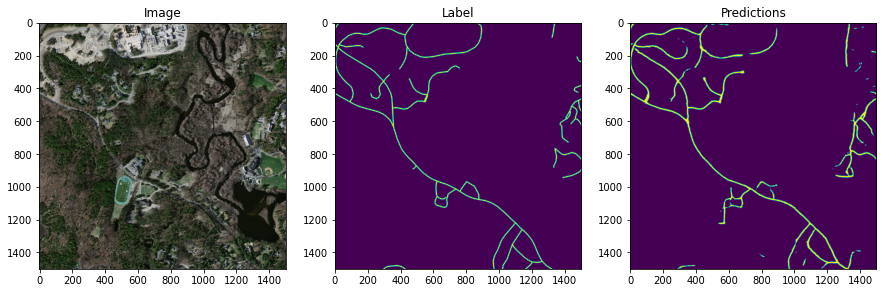

[0. 1.]
Till Mean IOU: 0.58098817


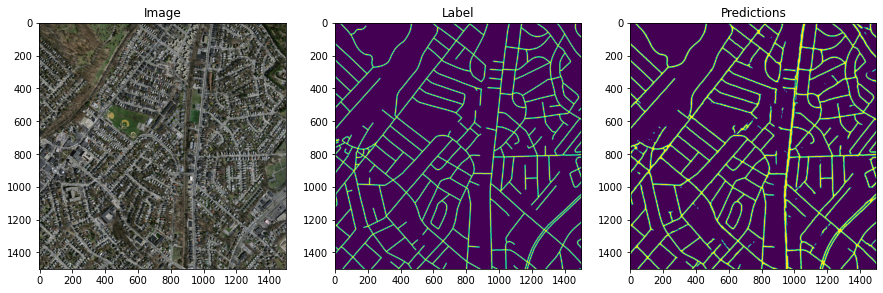

Mean IOU: 0.58098817
std IOU: 0.056133933
z IOU: 10.350035


In [15]:
iou_lst=[]
_,validation_data=get_datasets()
for data in validation_data:
    print(data[0].shape)
    patches=tf.image.extract_patches(data[0],
                                         sizes=[1, 512, 512, 1],
                                         strides=[1, 512, 512, 1],
                                         rates=[1, 1, 1, 1],
                                         padding='SAME')
    
    patches=tf.reshape(patches,(data[0].shape[0]*9,512,512,3))
    predictions=model_final.predict(patches)
    
    for i in range(data[0].shape[0]):
        prediction_res=np.zeros((512*3,512*3,1))       
        
        
        prediction_res[512*0:512*1,512*0:512*1,:]=predictions[0+(i*9),:,:,:]        
        prediction_res[512*0:512*1,512*1:512*2,:]=predictions[1+(i*9),:,:,:]
        prediction_res[512*0:512*1,512*2:512*3,:]=predictions[2+(i*9),:,:,:]
        
        
        prediction_res[512*1:512*2,512*0:512*1,:]=predictions[3+(i*9),:,:,:]
        prediction_res[512*1:512*2,512*1:512*2,:]=predictions[4+(i*9),:,:,:]
        prediction_res[512*1:512*2,512*2:512*3,:]=predictions[5+(i*9),:,:,:]
        
        
        prediction_res[512*2:512*3,512*0:512*1,:]=predictions[6+(i*9),:,:,:]
        prediction_res[512*2:512*3,512*1:512*2,:]=predictions[7+(i*9),:,:,:]
        prediction_res[512*2:512*3,512*2:512*3,:]=predictions[8+(i*9),:,:,:]
        


        fig,(ax1,ax2,ax3)=plt.subplots(1,3,figsize=(15, 5))
        ax1.imshow(data[0][i,:,:,:])
        ax1.set_title('Image')
        
        ax2.imshow(data[1][i,:,:,:])
        ax2.set_title('Label')
        
        result=tf.cast(prediction_res[18:-18,18:-18,:]>0.2,tf.float32)
        ax3.imshow(result)
        ax3.set_title('Predictions')  
        
        result=result.numpy()
        print(np.unique(result))
#         im = Image.fromarray(np.squeeze(result*255).astype(np.uint8))
#         im.save("test_predictions/" + data[2][i].numpy().decode('utf8'))
        res_iou=iou_fun(data[1][i,:,:,:],result)        
        iou_lst.append(res_iou)
        print('Till Mean IOU:',np.mean(iou_lst))
        plt.show()
print("Mean IOU:",np.mean(iou_lst))
print("std IOU:",np.std(iou_lst))
print("z IOU:",np.mean(iou_lst)/np.std(iou_lst))

<h2> Visualization For Cutoff=0.3</h2>

(13, 1500, 1500, 3)
[0. 1.]
Till Mean IOU: 0.5534562


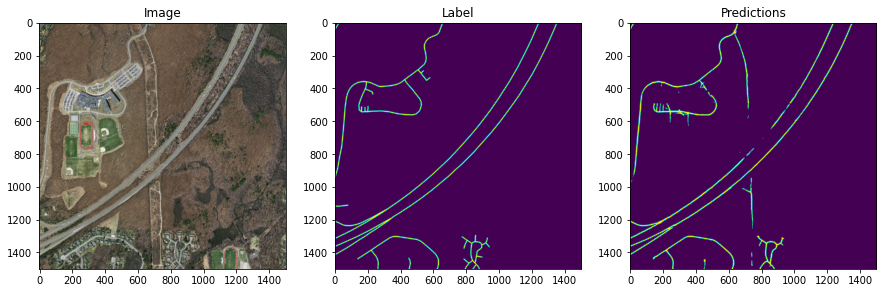

[0. 1.]
Till Mean IOU: 0.55004025


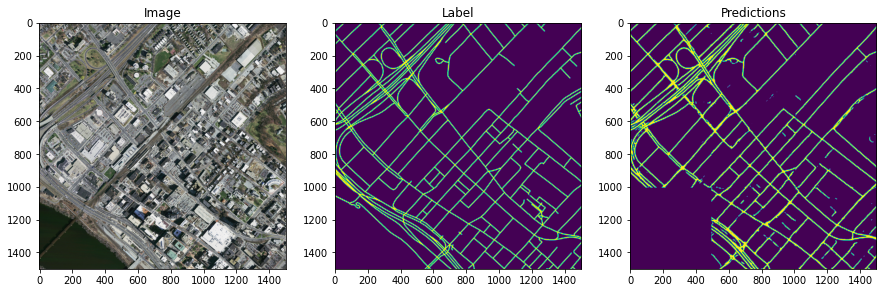

[0. 1.]
Till Mean IOU: 0.5892544


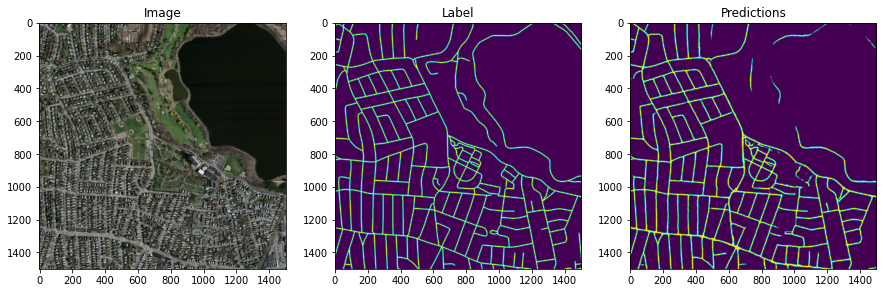

[0. 1.]
Till Mean IOU: 0.6026438


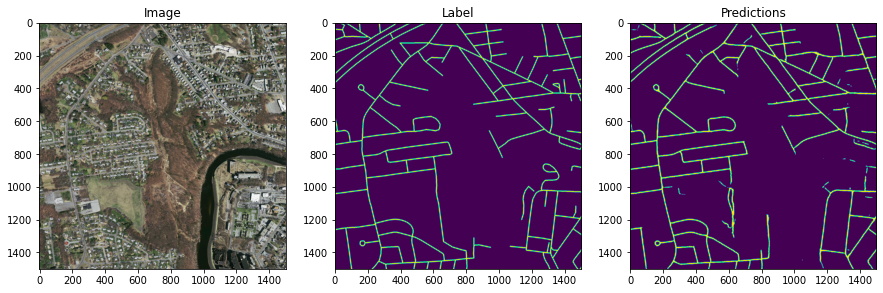

[0. 1.]
Till Mean IOU: 0.59920114


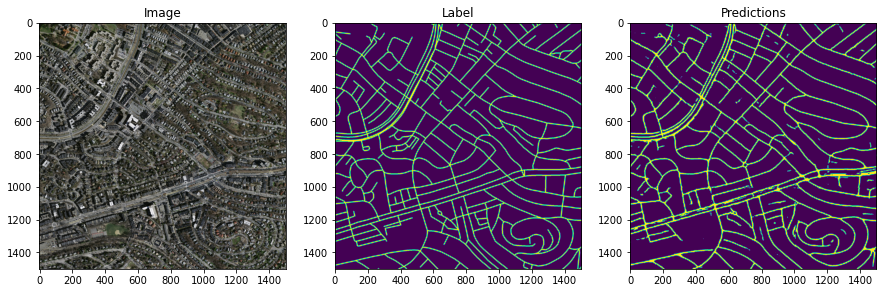

[0. 1.]
Till Mean IOU: 0.5922978


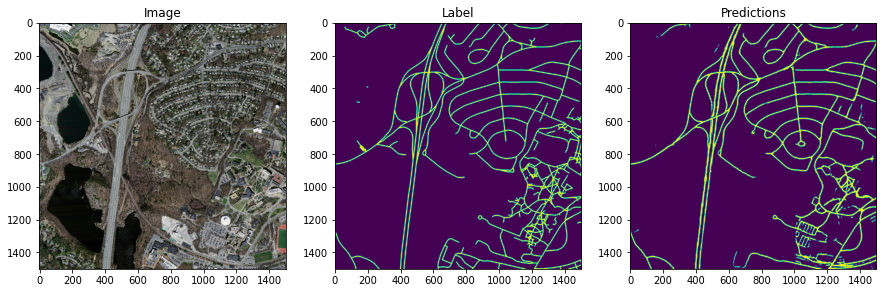

[0. 1.]
Till Mean IOU: 0.59955555


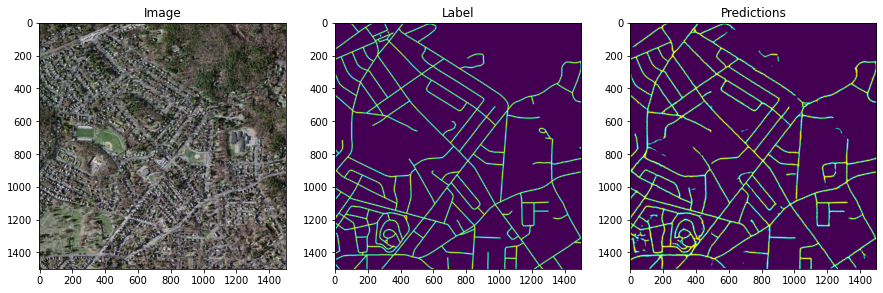

[0. 1.]
Till Mean IOU: 0.6092486


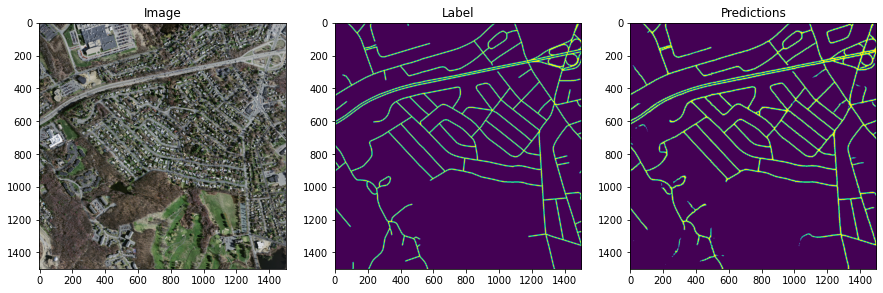

[0. 1.]
Till Mean IOU: 0.5977891


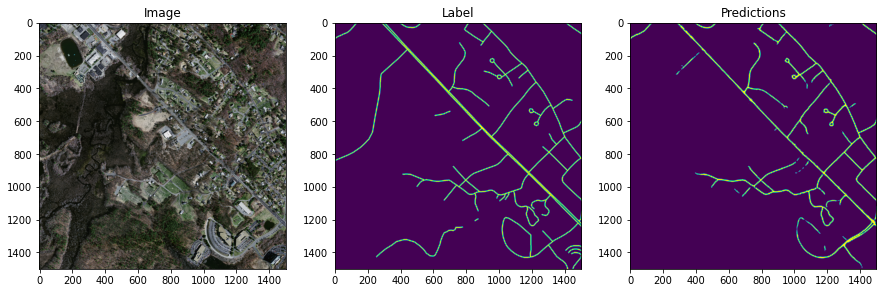

[0. 1.]
Till Mean IOU: 0.59838647


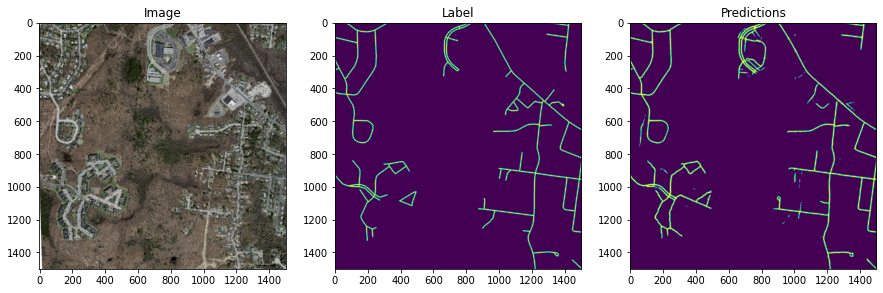

[0. 1.]
Till Mean IOU: 0.59942526


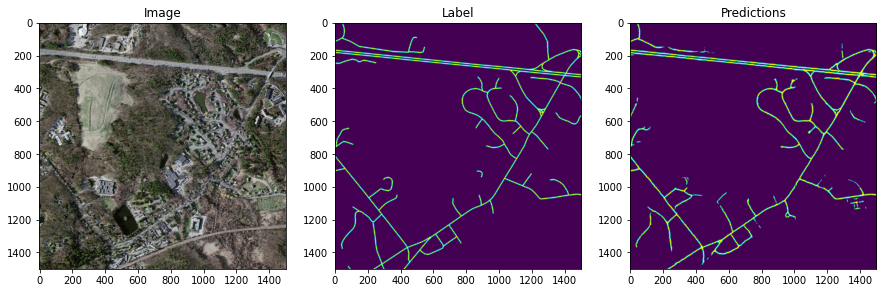

[0. 1.]
Till Mean IOU: 0.59039795


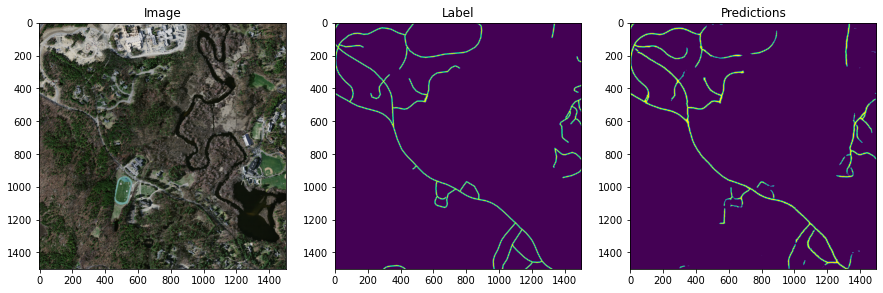

[0. 1.]
Till Mean IOU: 0.5966434


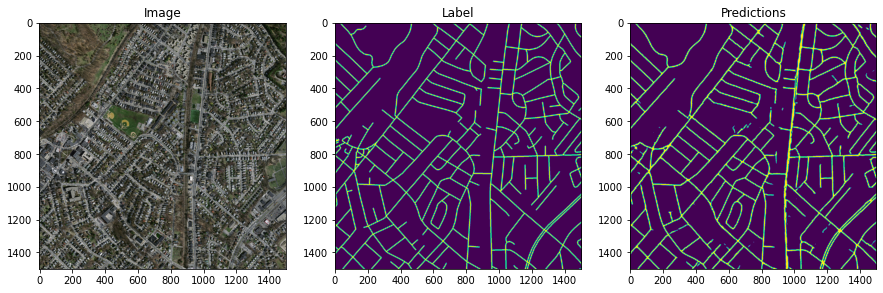

Mean IOU: 0.5966434
std IOU: 0.060121134
z IOU: 9.924021


In [16]:
iou_lst=[]
_,validation_data=get_datasets()
for data in validation_data:
    print(data[0].shape)
    patches=tf.image.extract_patches(data[0],
                                         sizes=[1, 512, 512, 1],
                                         strides=[1, 512, 512, 1],
                                         rates=[1, 1, 1, 1],
                                         padding='SAME')
    
    patches=tf.reshape(patches,(data[0].shape[0]*9,512,512,3))
    predictions=model_final.predict(patches)
    
    for i in range(data[0].shape[0]):
        prediction_res=np.zeros((512*3,512*3,1))       
        
        
        prediction_res[512*0:512*1,512*0:512*1,:]=predictions[0+(i*9),:,:,:]        
        prediction_res[512*0:512*1,512*1:512*2,:]=predictions[1+(i*9),:,:,:]
        prediction_res[512*0:512*1,512*2:512*3,:]=predictions[2+(i*9),:,:,:]
        
        
        prediction_res[512*1:512*2,512*0:512*1,:]=predictions[3+(i*9),:,:,:]
        prediction_res[512*1:512*2,512*1:512*2,:]=predictions[4+(i*9),:,:,:]
        prediction_res[512*1:512*2,512*2:512*3,:]=predictions[5+(i*9),:,:,:]
        
        
        prediction_res[512*2:512*3,512*0:512*1,:]=predictions[6+(i*9),:,:,:]
        prediction_res[512*2:512*3,512*1:512*2,:]=predictions[7+(i*9),:,:,:]
        prediction_res[512*2:512*3,512*2:512*3,:]=predictions[8+(i*9),:,:,:]
        


        fig,(ax1,ax2,ax3)=plt.subplots(1,3,figsize=(15, 5))
        ax1.imshow(data[0][i,:,:,:])
        ax1.set_title('Image')
        
        ax2.imshow(data[1][i,:,:,:])
        ax2.set_title('Label')
        
        result=tf.cast(prediction_res[18:-18,18:-18,:]>0.3,tf.float32)
        ax3.imshow(result)
        ax3.set_title('Predictions')  
        
        result=result.numpy()
        print(np.unique(result))
#         im = Image.fromarray(np.squeeze(result*255).astype(np.uint8))
#         im.save("test_predictions/" + data[2][i].numpy().decode('utf8'))
        res_iou=iou_fun(data[1][i,:,:,:],result)        
        iou_lst.append(res_iou)
        print('Till Mean IOU:',np.mean(iou_lst))
        plt.show()
print("Mean IOU:",np.mean(iou_lst))
print("std IOU:",np.std(iou_lst))
print("z IOU:",np.mean(iou_lst)/np.std(iou_lst))

<h2> Visualization For Cutoff=0.5</h2>

(13, 1500, 1500, 3)
[0. 1.]
Till Mean IOU: 0.54713476


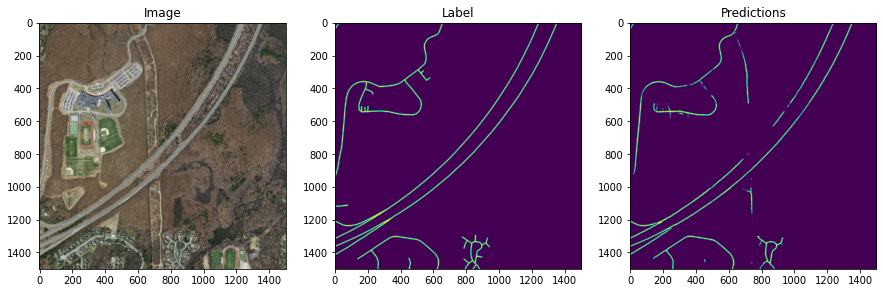

[0. 1.]
Till Mean IOU: 0.5342794


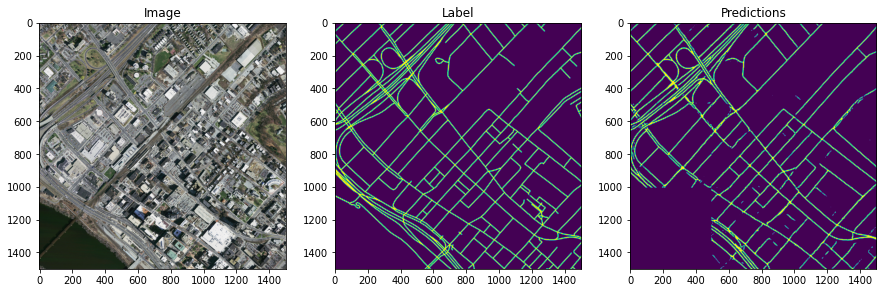

[0. 1.]
Till Mean IOU: 0.57273275


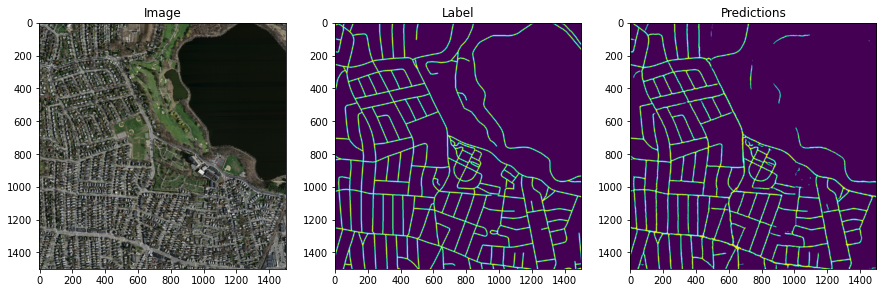

[0. 1.]
Till Mean IOU: 0.5897274


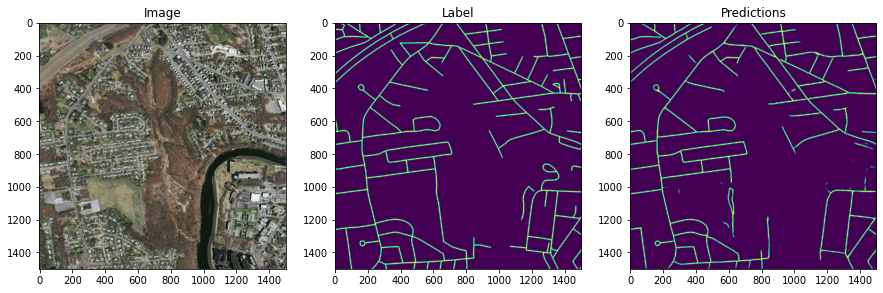

[0. 1.]
Till Mean IOU: 0.5879826


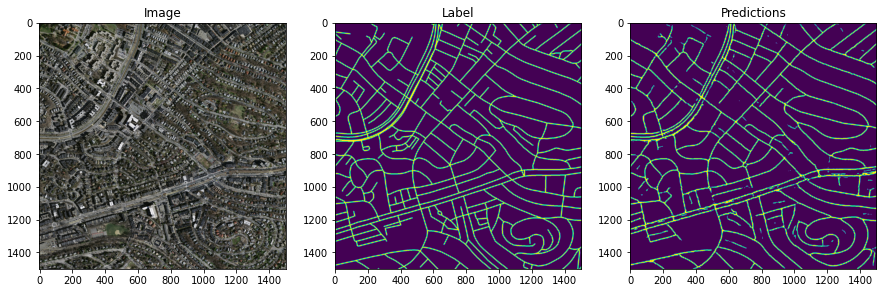

[0. 1.]
Till Mean IOU: 0.57948345


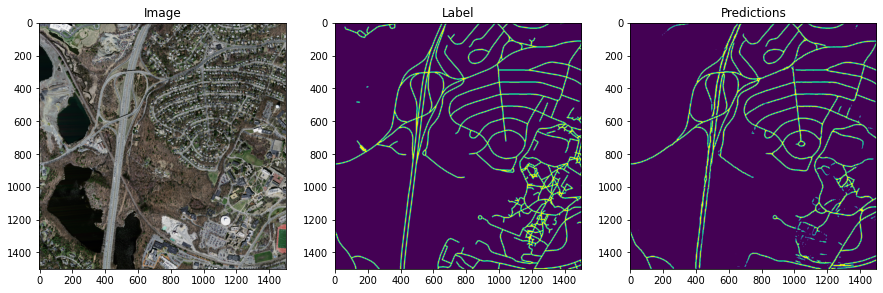

[0. 1.]
Till Mean IOU: 0.58867556


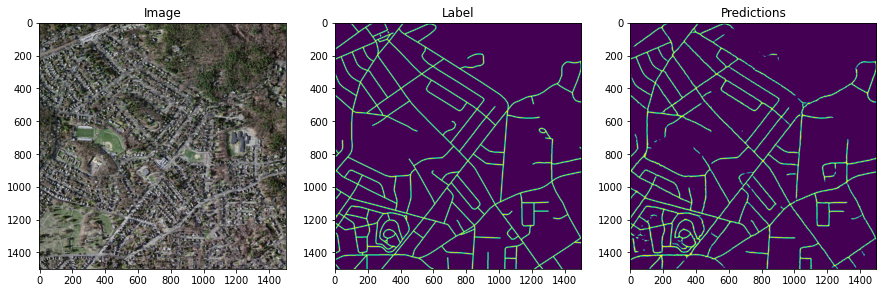

[0. 1.]
Till Mean IOU: 0.59940064


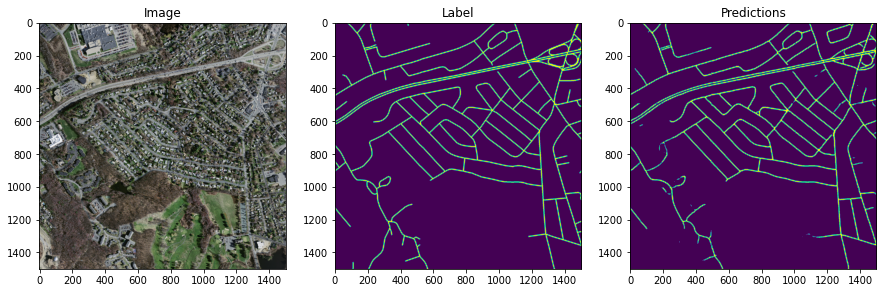

[0. 1.]
Till Mean IOU: 0.583205


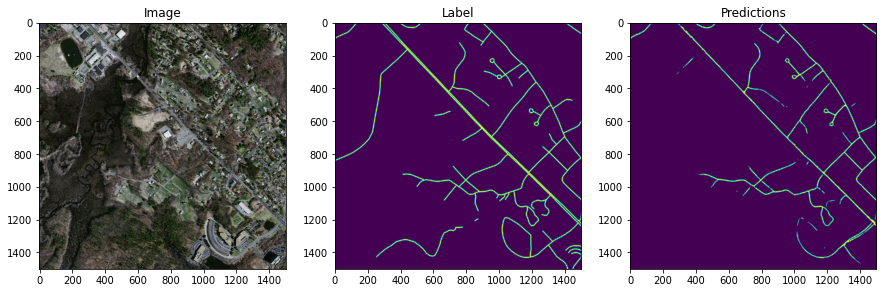

[0. 1.]
Till Mean IOU: 0.5865557


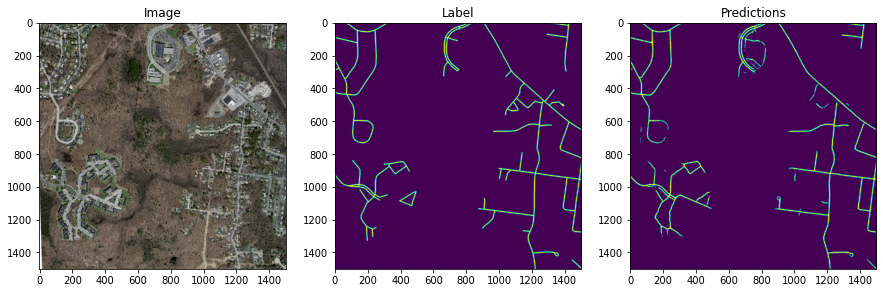

[0. 1.]
Till Mean IOU: 0.58775234


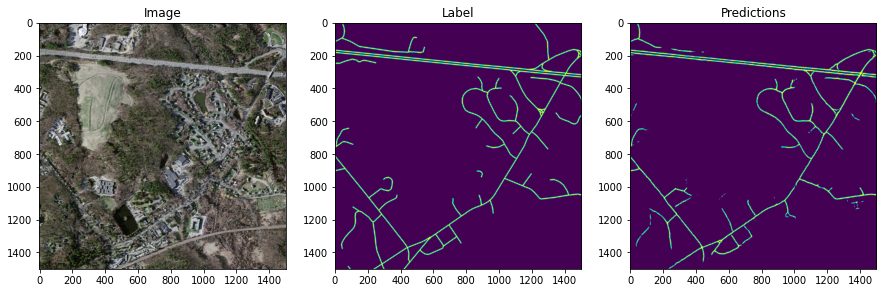

[0. 1.]
Till Mean IOU: 0.5774089


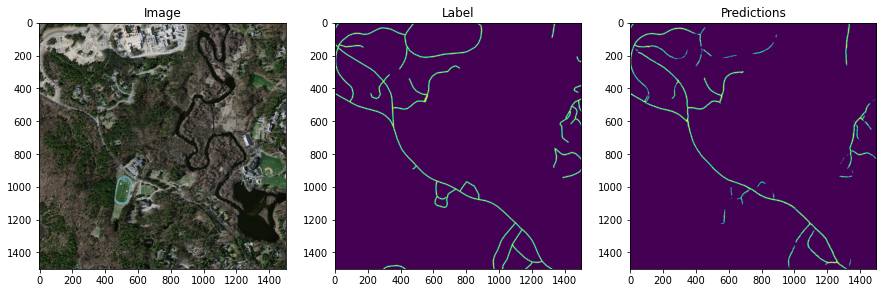

[0. 1.]
Till Mean IOU: 0.58491206


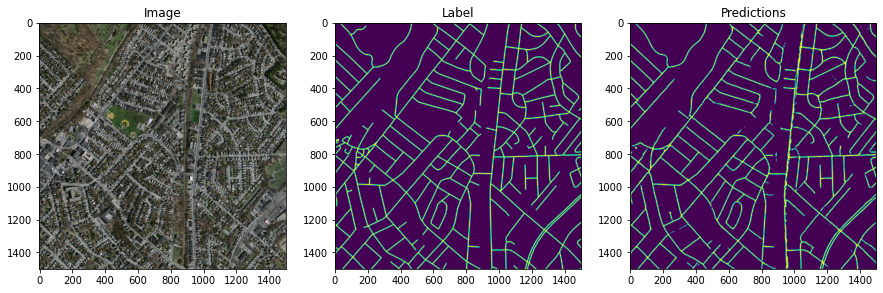

Mean IOU: 0.58491206
std IOU: 0.07224149
z IOU: 8.096622


In [17]:
iou_lst=[]
_,validation_data=get_datasets()

for data in validation_data:
    print(data[0].shape)
    patches=tf.image.extract_patches(data[0],
                                         sizes=[1, 512, 512, 1],
                                         strides=[1, 512, 512, 1],
                                         rates=[1, 1, 1, 1],
                                         padding='SAME')
    
    patches=tf.reshape(patches,(data[0].shape[0]*9,512,512,3))
    predictions=model_final.predict(patches)
    
    for i in range(data[0].shape[0]):
        prediction_res=np.zeros((512*3,512*3,1))       
        
        
        prediction_res[512*0:512*1,512*0:512*1,:]=predictions[0+(i*9),:,:,:]        
        prediction_res[512*0:512*1,512*1:512*2,:]=predictions[1+(i*9),:,:,:]
        prediction_res[512*0:512*1,512*2:512*3,:]=predictions[2+(i*9),:,:,:]
        
        
        prediction_res[512*1:512*2,512*0:512*1,:]=predictions[3+(i*9),:,:,:]
        prediction_res[512*1:512*2,512*1:512*2,:]=predictions[4+(i*9),:,:,:]
        prediction_res[512*1:512*2,512*2:512*3,:]=predictions[5+(i*9),:,:,:]
        
        
        prediction_res[512*2:512*3,512*0:512*1,:]=predictions[6+(i*9),:,:,:]
        prediction_res[512*2:512*3,512*1:512*2,:]=predictions[7+(i*9),:,:,:]
        prediction_res[512*2:512*3,512*2:512*3,:]=predictions[8+(i*9),:,:,:]
        


        fig,(ax1,ax2,ax3)=plt.subplots(1,3,figsize=(15, 5))
        ax1.imshow(data[0][i,:,:,:])
        ax1.set_title('Image')
        
        ax2.imshow(data[1][i,:,:,:])
        ax2.set_title('Label')
        
        result=tf.cast(prediction_res[18:-18,18:-18,:]>0.5,tf.float32)
        ax3.imshow(result)
        ax3.set_title('Predictions')  
        
        result=result.numpy()
        print(np.unique(result))
#         im = Image.fromarray(np.squeeze(result*255).astype(np.uint8))
#         im.save("test_predictions/" + data[2][i].numpy().decode('utf8'))
        res_iou=iou_fun(data[1][i,:,:,:],result)        
        iou_lst.append(res_iou)
        print('Till Mean IOU:',np.mean(iou_lst))
        plt.show()
print("Mean IOU:",np.mean(iou_lst))
print("std IOU:",np.std(iou_lst))
print("z IOU:",np.mean(iou_lst)/np.std(iou_lst))